In [1]:
from sklearn.cluster import SpectralClustering
from scipy.spatial import distance as dst
from collections import defaultdict
import shapely.geometry as sp
import pickle as pk
import pandas as pd
import distinctipy as ds
import matplotlib.pyplot as plt
import json
import math
import copy

<div>
<font size="4",style="font-family:Ubuntu"> <p> The following cell reads the East_File.csv file and divides all the USA Waypoints in it into 7 zones based on easting(x coordinate) ranges and divides each zone into chunks based on northing (y coordinate) ranges such that each chunk has approx 100k waypoints </p></font><br>
<font size="3">
<b>Input</b> &rarr; East_File.csv - (~53 Million Rows) <br>
<b>Output</b> &rarr; 25 .csv files each containing approx 100k rows/waypoints coordinates in a designated x-y range  </font>
</div>

In [24]:
dfE=pd.read_csv("Outputs/East_File.csv")
zones=[[0,1000000],[1000000,2000000],[2000000,3000000],[3000000,4000000],[4000000,5000000],[5000000,6000000],[6000000,7000000]]
chunks=[[[0,2000000],[2000000,4000000]],[[0,1500000],[1500000,2000000],[2000000,2500000],[2500000,4000000]],[[0,1350000],[1350000,1900000],[1900000,2400000],[2400000,4000000]],[[0,1000000],[1000000,1500000],[1500000,2000000],[2000000,2500000],[2500000,4000000]],[[0,800000],[800000,1250000],[1250000,1700000],[1700000,2150000],[2150000,2700000],[2700000,4000000]],[[0,1750000],[1750000,2300000],[2300000,4000000]],[[0,4000000]]]
zoneNumber=0
for zone in zones:
    chunkNumber=0
    for chunk in chunks[zoneNumber]:
        dfTemp=dfE[(dfE['easting']>=zone[0]) & (dfE['easting']<zone[1]) & (dfE['northing']>=chunk[0]) & (dfE['northing'] < chunk[1])]
        dfTemp=dfTemp.reset_index()
        dfTemp.drop(['index'],axis=1,inplace=True)
        dfTemp.to_csv(f"Outputs/ChunksClustering/Chunk{zoneNumber+1}_{chunkNumber+1}.csv",index=False)
        chunkNumber+=1
    zoneNumber+=1

<div>
<font size="4",style="font-family:Ubuntu"> <p> The following two cells reads the 25 .csv files (Chunks) generated above and applies Spectral Clustering to each, dividing each chunk into 5 Centres resulting in total 125 Centres. The input file(s) is the divided(chunkified) East_File.csv and the output is a single file ->finalUSMap.csv which associates to each waypoint in the input file a number -> 'label' which represents the mapping between a waypoint and a centre. </p></font><br>
<font size="3">
<b>Input</b> &rarr; 25 .csv files (Chunkified East_File.csv) <br>
<b>Output</b> &rarr; finalUSMap.csv </font>
</div>

In [25]:
def getLabel(Chunk):
    sk=SpectralClustering(n_clusters=5 , affinity = "nearest_neighbors")
    label=sk.fit_predict(Chunk)
    return label
def getCVec(label):
    colors=ds.get_colors(5)
    cvec=[colors[i] for i in label]
    return cvec
colors=ds.get_colors(125)
chunks=[["Chunk1_1.csv","Chunk1_2.csv"],["Chunk2_1.csv","Chunk2_2.csv","Chunk2_3.csv","Chunk2_4.csv"],["Chunk3_1.csv","Chunk3_2.csv","Chunk3_3.csv","Chunk3_4.csv"],["Chunk4_1.csv","Chunk4_2.csv","Chunk4_3.csv","Chunk4_4.csv","Chunk4_5.csv"],["Chunk5_1.csv","Chunk5_2.csv","Chunk5_3.csv","Chunk5_4.csv","Chunk5_5.csv","Chunk5_6.csv"],["Chunk6_1.csv","Chunk6_2.csv","Chunk6_3.csv"],["Chunk7_1.csv"]]
FileNames=["Chunk1_1.csv","Chunk1_2.csv","Chunk2_1.csv","Chunk2_2.csv","Chunk2_3.csv","Chunk2_4.csv","Chunk3_1.csv","Chunk3_2.csv","Chunk3_3.csv","Chunk3_4.csv","Chunk4_1.csv","Chunk4_2.csv","Chunk4_3.csv","Chunk4_4.csv","Chunk4_5.csv","Chunk5_1.csv","Chunk5_2.csv","Chunk5_3.csv","Chunk5_4.csv","Chunk5_5.csv","Chunk5_6.csv","Chunk6_1.csv","Chunk6_2.csv","Chunk6_3.csv","Chunk7_1.csv"]
for File in FileNames:
    df=pd.read_csv(f"Outputs/ChunksClustering/{File}")
    label=getLabel(df)
    cvec=getCVec(label)
    df['label']=label
    df.to_csv(f"ChunksClustering/{File}",index=False)

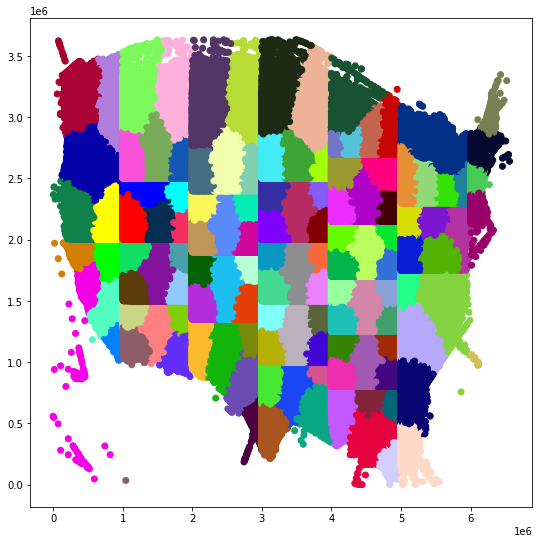

In [45]:
centre_label=0
allChunksDf=pd.DataFrame()
for chunk in chunks:
    chunkDataFrame=pd.DataFrame()
    for subChunk in chunk:
        chunkDf=pd.read_csv(f"ChunksClustering/{subChunk}")
        chunkDf['label']+=5*centre_label
        chunkDataFrame=pd.concat([chunkDataFrame,chunkDf])
        centre_label+=1
    allChunksDf=pd.concat([allChunksDf,chunkDataFrame])
labels=list(allChunksDf['label'])
cvec = [colors[label] for label in labels]
plt.figure(figsize =(9, 9))
plt.scatter(allChunksDf['easting'], allChunksDf['northing'], c = cvec)
allChunksDf.to_csv("Outputs/finalUSMap.csv",index=False)
plt.savefig(f"Outputs/USMap.png")

<div>
<font size="4",style="font-family:Ubuntu"> <p> The following two cells reads the finalUSMap.csv file generated above and applies Spectral Clustering to each one of the 125 centres, dividing each centre into 10 sectors resulting in total 1250 sectors. The input file(s) is the divided(chunkified) finalUSMap.csv and the output is a single file ->US_SectorMap.csv which associates to each waypoint in the input file a number -> 'sector' which represents the mapping between a waypoint and a sector. </p></font><br>
<font size="3">
<b>Input</b> &rarr; finalUSMap.csv <br>
<b>Output</b> &rarr; US_SectorMap.csv </font>
</div>

In [5]:
def getLabelForSector(Chunk):
    sk=SpectralClustering(n_clusters=10 , affinity = "nearest_neighbors")
    label=sk.fit_predict(Chunk)
    return label

dfUSmap=pd.read_csv("Outputs/finalUSMap.csv")

labelno=0
dfSector=pd.DataFrame()
while labelno<125:    
    dftemp=dfUSmap[dfUSmap['label']==labelno]
    dftemp=dftemp.reset_index()
    dftemp.drop(['index'],axis=1,inplace = True)
    label=getLabelForSector(dftemp)
    label=list(map(lambda x:x+(10*labelno),label))
    dftemp['sector']=label
    dfSector=pd.concat([dfSector,dftemp])
    labelno+=1
dfSector.to_csv("Outputs/US_SectorMap.csv",index=False)

<div>
<font size="4",style="font-family:Ubuntu"> <p> The following cell plots reads US_SectorMap.csv and plots all the 1250 sectors. </p></font><br>
<font size="3">
<b>Input</b> &rarr; US_SectorMap.csv <br>
<b>Output</b> &rarr; USMapSectors.png which is a plot of all 1250 sectors </font>
</div>

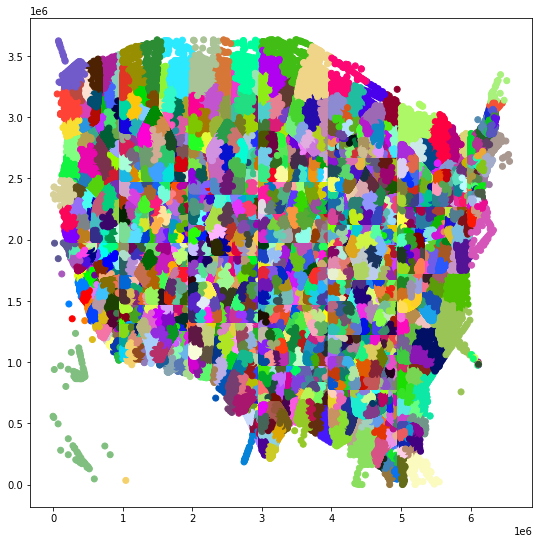

In [8]:
colors=ds.get_colors(1250)
dfSector=pd.read_csv("Outputs/US_SectorMap.csv")
labels=list(dfSector['sector'])
cvec = [colors[label] for label in labels]
plt.figure(figsize =(9, 9))
plt.scatter(dfSector['easting'], dfSector['northing'], c = cvec)
plt.savefig("Outputs/USMapSectors.png")

<div>
<font size="4",style="font-family:Ubuntu"> <p> The following cell implements Chan's Algorithm which finds the convex hull given a set of points</p></font><br>
<font size="3">
<b>Input</b> &rarr; Set of points <br>
<b>Output</b> &rarr; Convex hull </font>
</div>

In [8]:
class Point:
       def __init__(self,x,y):
            self.x=x
            self.y=y
def crossProduct(O,A,B):
     return (A.x - O.x) * (B.y - O.y)- (A.y - O.y) * (B.x - O.x)
def convexHull(points):
    n=len(points)
    k=0
    if n<=3:
        return points
    ans=[None]*(2*n)
    points=sorted(points,key=lambda o:(o.x,o.y))
    for i in range(n):
        while k >= 2 and crossProduct(ans[k - 2], ans[k - 1], points[i]) <= 0:
            k-=1
        ans[k]=points[i]
        k+=1
    t=k+1
    for i in range(n-1,0,-1):
        while k >= t and crossProduct(ans[k - 2],ans[k - 1], points[i - 1]) <= 0:
            k-=1
        ans[k] = points[i - 1]
        k+=1
    ans=ans[:k-1]
    return ans

<div>
<font size="4",style="font-family:Ubuntu"> <p> The following cell reads US_SectorMap.csv and applies Chan's Algorithm to find the convex hull and maps each sector to the convex hull corresponding to it</p></font><br>
<font size="3">
<b>Input</b> &rarr; US_SectorMap.csv <br>
<b>Output</b> &rarr; ConvexDict.pkl which maps sector to it's convex hull </font>
</div>

In [40]:
df=pd.read_csv("Outputs/US_SectorMap.csv")
sectorBoundaryMap=dict()
sectorNumber=0
while sectorNumber<1250:
    dfSector=df[df["sector"]==sectorNumber]
    easting=list(dfSector['easting'])
    northing=list(dfSector['northing'])
    v=list(zip(easting,northing))
    v=list(map(lambda p:Point(p[0],p[1]),v))
    ans=convexHull(v)
    ans=list(map(lambda p:(p.x,p.y),ans))
    sectorBoundaryMap[sectorNumber]=ans
    sectorNumber+=1
ConvexDict = open("Outputs/ConvexDict.pkl", "wb")
pk.dump(sectorBoundaryMap, ConvexDict)
ConvexDict.close()

<div>
<font size="4",style="font-family:Ubuntu"> <p> The following cell reads ConvexDict.pkl and generates a mapping between every airport and the sector they belong to - This is negated Refer to Metrics.ipynb</p></font><br>
<font size="3">
<b>Input</b> &rarr; ConvexDict.pkl,AirportsFinal.csv <br>
<b>Output</b> &rarr; airportDict.pkl which is mapping between every airport and the sector they belong to</font>
</div>

In [2]:
airportDict=dict()
output = pk.load(open("Outputs/ConvexDict.pkl", "rb"))
dfAirFinal=pd.read_csv("Outputs/AirportsFinal.csv")
airportList=list(dfAirFinal["airport"])
def getAirportToSectorMapping(airport):
    dfAirport=dfAirFinal[dfAirFinal["airport"]==airport]
    dfAirport=dfAirport.reset_index()
    dfAirport.drop(['index'],axis=1,inplace=True)
    air=dfAirport.airport[0]
    east=dfAirport.easting[0]
    north=dfAirport.northing[0]
    for i in range(1250):
        doesContain=sp.Polygon(output[i]).contains(sp.Point((east,north)))
        if doesContain:
            airportDict[air]=i
            break
for airport in airportList:
    getAirportToSectorMapping(airport)
airportDictFile=open("Outputs/airportDict.pkl","wb")
pk.dump(airportDict,airportDictFile)
airportDictFile.close()

<div>
<font size="4",style="font-family:Ubuntu"> <p> The following cell reads the airportFinal.csv file and writes the relevant airport information like name city state along with the host sector into a text file which will be used for the frontend simulator</p></font><br>
<font size="3">
<b>Input</b> &rarr; AirportsFinal.csv,airports.json,airportDict.pkl <br>
<b>Output</b> &rarr; airports.txt</font>
</div>

In [4]:
dfAirports=pd.read_csv("Outputs/AirportsFinal.csv")
airport_list = open("Outputs/airports.txt","w")
f = open('Inputs/airports.json')
mapping = pk.load(open("Outputs/airportDict.pkl", "rb"))
data = json.load(f)
for airport in airportList:
    to_write=""
    to_write+=f"{airport},{data[airport]['name']},{data[airport]['state']},{mapping[airport]}\n"
    airport_list.write(to_write)
airport_list.close()

<div>
<font size="4",style="font-family:Ubuntu"> <p> The following cell reads ConvexDict.pkl and US_SectorMap.csv and gives all visual representation of all the convex hulls </p></font><br>
<font size="3">
<b>Input</b> &rarr; ConvexDict.pkl , US_SectorMap.csv <br>
<b>Output</b> &rarr; NodeMap.png is a visual representation of all the convex hulls</font>
</div>

In [5]:
ConvexDictRead = open("Outputs/ConvexDict.pkl", "rb")
output = pk.load(ConvexDictRead)
airports= pd.read_csv("Outputs/AirportsFinal.csv")
xAir=airports['easting']
yAir=airports['northing']
airportList=list(airports["airport"])
df=pd.read_csv("Outputs/US_SectorMap.csv")
sectorNumber=0
dpi=96
fig=plt.figure(figsize=(200,200),dpi=dpi)
while sectorNumber<1250:
    x=output[sectorNumber]
    x1=list(map(lambda p:p[0],x))
    y1=list(map(lambda p:p[1],x))
    x2=list(df[df['sector']==sectorNumber]['easting'])
    y2=list(df[df['sector']==sectorNumber]['northing'])
    x3=sorted(x1)
    y3=sorted(y1)
    xmid=(x3[0]+x3[-1])/2
    ymid=(y3[0]+y3[-1])/2
    plt.text(xmid,ymid,f"{sectorNumber}",fontsize=60)
    plt.plot(x1,y1,'r')
    plt.plot([x1[0],x1[-1]],[y1[0],y1[-1]],'r')
    sectorNumber+=1
plt.scatter(xAir,yAir,marker='o' , s=3000)
for i, txt in enumerate(airportList):
    plt.annotate(txt, (xAir[i], yAir[i]),fontsize=70,color ="red")
plt.savefig("Outputs/NodeMap.png",dpi=dpi)